# Label ATL03 photons with ATL08 classification

In [1]:
import os

import sys
sys.path.append('/home/pmontesa/code/gedipy')

from gedipy import h5io

import numpy
import pyproj

import pandas as pd
import geopandas as gpd
from geopandas import GeoDataFrame

import matplotlib.pyplot as plt
import ipywidgets

sys.path.append('/home/pmontesa/code')
import maplib

import plotnine
from plotnine import *

try:
    from maap.maap import MAAP
    HAS_MAAP = True
except ImportError:
    print('NASA MAAP is unavailable')
    HAS_MAAP = False

/gpfsm/ccds01/home/appmgr/app/jupyterhub/ilab/kernel/lib/python3.7/site-packages/requests/__init__.py:104: RequestsDependencyWarning: urllib3 (1.26.12) or chardet (5.0.0)/charset_normalizer (2.0.10) doesn't match a supported version!
  RequestsDependencyWarning)


NASA MAAP is unavailable


## Download an ATL03 and ATL08 orbit pair

In [2]:
ATLAS_version = 5

if HAS_MAAP:
    maap = MAAP()
    
    atl03_granules = maap.searchGranule(collection_concept_id='C1200166513-NASA_MAAP', 
                        readable_granule_name='ATL03_20190212000416_06950214_002_01.h5')
    atl03_filename = atl03_granules[0]['Granule']['DataGranule']['ProducerGranuleId']
    if not os.path.exists(atl03_filename):
        atl03_granules[0].getLocalPath('.')

    atl08_granules = maap.searchGranule(collection_concept_id='C1200116818-NASA_MAAP', 
                        readable_granule_name='ATL08_20190212000416_06950214_002_01.h5')
    atl08_filename = atl08_granules[0]['Granule']['DataGranule']['ProducerGranuleId']
    if not os.path.exists(atl08_filename):
        atl08_granules[0].getLocalPath('.')
        
else:
    if True:
        site = 'Senegal'
        granule_list = [f'ATL08_20210707050138_02071207_{ATLAS_version:003}_01.h5']
        #atl03_filename = f'/css/icesat-2/ATLAS/ATL03.00{ATLAS_version}/2019.03.31/ATL03_20190331082243_00320301_{ATLAS_version:003}_01.h5'
        #atl08_filename = f'/css/icesat-2/ATLAS/ATL08.00{ATLAS_version}/2019.03.31/ATL08_20190331082243_00320301_{ATLAS_version:003}_01.h5'
        minlon = -180
        maxlon = 180 
        minlat = 10
        maxlat = 14
    if False:
        site = 'Kheta-Khatanga'
        #atl03_filename = f'/css/icesat-2/ATLAS/ATL03.00{ATLAS_version}/2021.06.22/ATL03_20210622221234_13761105_00{ATLAS_version}_01.h5'
        #atl08_filename = f'/css/icesat-2/ATLAS/ATL08.00{ATLAS_version}/2021.06.22/ATL08_20210622221234_13761105_00{ATLAS_version}_01.h5'
        granule_list = [f'ATL08_20210622221234_13761105_{ATLAS_version:003}_01.h5'] 
        minlon = -180
        maxlon = 180 
        minlat = 68
        maxlat = 72
    if False:
        site = 'Bhasan-Char'
        granule_list = [f'ATL08_20190108172326_01720207_{ATLAS_version:003}_01.h5',
                  f'ATL08_20190402011415_00580301_{ATLAS_version:003}_01.h5',
                  f'ATL08_20191008042249_01720507_{ATLAS_version:003}_01.h5',
                  f'ATL08_20191230121332_00580601_{ATLAS_version:003}_01.h5',
                  f'ATL08_20200107000234_01720607_{ATLAS_version:003}_01.h5',
                  f'ATL08_20200406194221_01720707_{ATLAS_version:003}_01.h5',
                  f'ATL08_20200629033305_00580801_{ATLAS_version:003}_01.h5',
                  f'ATL08_20201227185244_00581001_{ATLAS_version:003}_01.h5',
                  f'ATL08_20210104064149_01721007_{ATLAS_version:003}_01.h5']
        g = granule_list[5]
        g = f'ATL08_20211025042833_05001301_{ATLAS_version:003}_01.h5'
        # Granules from Jamon
        atl03_df_dict = {}
        granule_list = [\
                    f'ATL08_20210104064149_01721007_{ATLAS_version:003}_01.h5', \
                    f'ATL08_20200406194221_01720707_{ATLAS_version:003}_01.h5', \
                    f'ATL08_20200107000234_01720607_{ATLAS_version:003}_01.h5', \
                    f'ATL08_20191230121332_00580601_{ATLAS_version:003}_01.h5', \
                    f'ATL08_20191008042249_01720507_{ATLAS_version:003}_01.h5' ]
        # # Spatial Filters
        # # Bhasan Char
        # minlat = 22.38307
        #minlon = 91.35849
        # maxlat = 22.41237
        #maxlon = 91.40732
        minlat_atl08 = 21.5
        maxlat_atl08 = 25.5

        minlon = 91.36436
        maxlon = 91.44264
        minlat = 22.32848
        maxlat = 22.41103
        
    # Manually indicate focal granule 
    g = granule_list[0]
    g1, g2, g3, g4, g5 = g.split('_')
    atl03_filename = f'/css/icesat-2/ATLAS/ATL03.{ATLAS_version:003}/{g2[0:4]}.{g2[4:6]}.{g2[6:8]}/ATL03_{g2}_{g3}_{ATLAS_version:003}_01.h5'
    atl08_filename = f'/css/icesat-2/ATLAS/ATL08.{ATLAS_version:003}/{g2[0:4]}.{g2[4:6]}.{g2[6:8]}/ATL08_{g2}_{g3}_{ATLAS_version:003}_01.h5'
    
atl03_filename

'/css/icesat-2/ATLAS/ATL03.005/2021.07.07/ATL03_20210707050138_02071207_005_01.h5'

In [3]:
import h5py
atl08_file = h5py.File(atl08_filename, 'r')
list(atl08_file)

# Get beamlist from ATL08
beamlist = [group for i, group in enumerate(list(atl08_file)) if 'gt' in group]
print(beamlist)

atl03_file = h5py.File(atl03_filename, 'r')
list(atl03_file)


['gt1l', 'gt1r', 'gt2l', 'gt2r', 'gt3l', 'gt3r']


['METADATA',
 'ancillary_data',
 'atlas_impulse_response',
 'ds_surf_type',
 'ds_xyz',
 'gt1l',
 'gt1r',
 'gt2l',
 'gt2r',
 'gt3l',
 'gt3r',
 'orbit_info',
 'quality_assessment']

## Open the input files

In [4]:
# Open the ATL03 file
atl03_fid = h5io.ATL03H5File(atl03_filename)
atl03_fid.open_h5()

# Open the ATL08 file
atl08_fid = h5io.ATL08H5File(atl08_filename)
atl08_fid.open_h5()

beamlist = [ beam for beam in atl08_fid.beams ]
beamlist

['gt1l', 'gt1r', 'gt2l', 'gt2r', 'gt3l', 'gt3r']

## Select a power beam

In [5]:
# Which beams are power/weak depends on the orientation of the satellite
atlas_orientation = atl03_fid.get_atlas_orientation()
if atlas_orientation == 'backward':
    power_beams = [beam for beam in atl03_fid.beams if beam.endswith('l')]
elif atlas_orientation == 'forward':
    power_beams = [beam for beam in atl03_fid.beams if beam.endswith('r')]
else:
    print('ATLAS orientation in transition, do not use')

# Select the RGT center power beam for this example
beam = next(power_beam for power_beam in power_beams if 'gt2' in power_beam)

# Is it night or day?
night_flag = atl08_fid.get_dataset(beam, 'land_segments/night_flag')
print('{:.2f}% of the land segments are night time'.format(sum(night_flag)/night_flag.size))

1.00% of the land segments are night time


In [6]:
power_beams

['gt1r', 'gt2r', 'gt3r']

## Print the H5 file structure

In [7]:
def printname(name):
    """ prints names of ICESat file
    
    Note: callback used in combination with f.visit(printname)
    """
    print(name)
#atl03_file[beam].visit(printname)

In [8]:
#atl08_file[beam].visit(printname)

In [9]:
dataset_list_for_export = ['land_segments/latitude','land_segments/longitude',
                           'land_segments/solar_elevation',
                           'land_segments/msw_flag','land_segments/segment_snowcover','land_segments/segment_watermask','land_segments/night_flag','land_segments/segment_landcover',
                          'land_segments/canopy/h_canopy','land_segments/canopy/n_toc_photons','land_segments/canopy/n_ca_photons']

dataset_terrain_list_for_export = ['land_segments/terrain/h_te_best_fit','land_segments/terrain/h_te_interp','land_segments/terrain/h_te_max','land_segments/terrain/h_te_mean','land_segments/terrain/h_te_median',
'land_segments/terrain/h_te_min','land_segments/terrain/h_te_mode','land_segments/terrain/h_te_rh25','land_segments/terrain/h_te_skew','land_segments/terrain/h_te_std','land_segments/terrain/h_te_uncertainty', 'land_segments/terrain/terrain_slope']

#dataset_list_for_export = dataset_list_for_export.append(dataset_terrain_list_for_export)

In [10]:
print(dataset_list_for_export + dataset_terrain_list_for_export)

['land_segments/latitude', 'land_segments/longitude', 'land_segments/solar_elevation', 'land_segments/msw_flag', 'land_segments/segment_snowcover', 'land_segments/segment_watermask', 'land_segments/night_flag', 'land_segments/segment_landcover', 'land_segments/canopy/h_canopy', 'land_segments/canopy/n_toc_photons', 'land_segments/canopy/n_ca_photons', 'land_segments/terrain/h_te_best_fit', 'land_segments/terrain/h_te_interp', 'land_segments/terrain/h_te_max', 'land_segments/terrain/h_te_mean', 'land_segments/terrain/h_te_median', 'land_segments/terrain/h_te_min', 'land_segments/terrain/h_te_mode', 'land_segments/terrain/h_te_rh25', 'land_segments/terrain/h_te_skew', 'land_segments/terrain/h_te_std', 'land_segments/terrain/h_te_uncertainty', 'land_segments/terrain/terrain_slope']


## Export ATL08 data
- for power beams only

In [11]:
atl08_df = pd.concat([ atl08_fid.export_shots(beam, subset=False, dataset_list=dataset_list_for_export + dataset_terrain_list_for_export) for beam in power_beams]) 
atl08_df

,latitude,longitude,solar_elevation,msw_flag,segment_snowcover,segment_watermask,night_flag,segment_landcover,h_canopy,n_toc_photons,...,h_te_max,h_te_mean,h_te_median,h_te_min,h_te_mode,h_te_rh25,h_te_skew,h_te_std,h_te_uncertainty,terrain_slope
0,25.423359,-14.859041,-15.026612,3,0,1,1,200,3.402823e+38,0,...,33.753250,33.266644,33.312401,32.619328,3.330000e+01,33.062237,-0.446792,0.272073,0.707834,-0.002707
1,25.422459,-14.859140,-15.027154,3,0,1,1,200,6.200722e+00,1,...,33.708630,33.146488,33.109550,32.547421,3.310000e+01,33.000397,0.031498,0.235391,0.705271,0.002273
2,25.421556,-14.859235,-15.027695,3,0,1,1,200,7.726494e+00,1,...,33.852604,33.046001,32.998505,32.499722,3.300000e+01,32.773186,0.359982,0.352470,0.524577,-0.009375
3,25.420656,-14.859330,-15.028228,3,0,1,1,200,3.402823e+38,0,...,33.793892,33.220501,33.195320,32.609119,3.340000e+01,33.050152,-0.092757,0.269877,0.615223,-0.000663
4,25.419756,-14.859430,-15.028778,3,0,1,1,200,3.402823e+38,0,...,33.635326,33.184990,33.228172,32.579979,3.330000e+01,33.042435,-0.405454,0.252196,0.572179,-0.001388
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13528,11.292907,-16.392122,-23.184374,2,1,0,1,30,7.913853e+00,10,...,31.743374,31.163816,31.083429,30.660868,3.100000e+01,30.983496,0.618880,0.277174,0.636032,-0.007634
13529,11.292005,-16.392218,-23.184858,2,1,0,1,126,7.782551e+00,29,...,36.671787,34.018463,34.201920,31.001432,3.402823e+38,32.033821,-0.139404,1.840737,2.839225,0.057404
13530,11.291102,-16.392305,-23.185345,2,1,0,1,126,5.406120e+00,34,...,36.931271,36.597202,36.592102,36.263145,3.670000e+01,36.517807,0.151633,0.157419,1.663543,0.001764
13531,11.290200,-16.392393,-23.185831,2,1,0,1,126,7.151863e+00,23,...,40.014816,37.423187,36.798031,36.387733,3.670000e+01,36.602680,0.952679,1.063871,1.970493,0.034430


In [12]:
atl08_df.rename(columns={'longitude': 'lon', 'latitude': 'lat', 'night_flag':'night_flg', 'h_canopy':'h_can'}, inplace=True)
atl08_gdf = GeoDataFrame(atl08_df, geometry=gpd.points_from_xy(atl08_df.lon, atl08_df.lat), crs='epsg:4326')
atl08_gdf = atl08_gdf[
                                    (atl08_gdf.msw_flag == 0) & 
                                    (atl08_gdf.n_ca_photons > 0) &
                                    (atl08_gdf.h_can < 100) &
                                    (atl08_gdf.segment_snowcover == 1) &
                                    (atl08_gdf.segment_watermask == 0)
                                ]
if False:
    atl08_gdf = atl08_gdf[(atl08_gdf.lat > minlat_atl08) &
                          (atl08_gdf.lat < maxlat_atl08) 
                     ]

print(atl08_gdf.shape)
atl08_gdf.info()

(179, 24)
<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 179 entries, 2155 to 12208
Data columns (total 24 columns):
 #   Column             Non-Null Count  Dtype   
---  ------             --------------  -----   
 0   lat                179 non-null    float32 
 1   lon                179 non-null    float32 
 2   solar_elevation    179 non-null    float32 
 3   msw_flag           179 non-null    int8    
 4   segment_snowcover  179 non-null    int8    
 5   segment_watermask  179 non-null    int32   
 6   night_flg          179 non-null    int32   
 7   segment_landcover  179 non-null    int16   
 8   h_can              179 non-null    float32 
 9   n_toc_photons      179 non-null    int32   
 10  n_ca_photons       179 non-null    int32   
 11  h_te_best_fit      179 non-null    float32 
 12  h_te_interp        179 non-null    float32 
 13  h_te_max           179 non-null    float32 
 14  h_te_mean          179 non-null    float32 
 15  h_te_median        179 non-null   

In [33]:
if False:
    m_atl08 = maplib.MAP_ATL08_FOLIUM(atl08_gdf.sample(frac=0.1), MAP_COL='h_can', GROUP_COL='segment_landcover', DO_NIGHT=False)
    m_atl08

## Export ATL03 data
TODO - subset the ATL03 data based on the ATL08 subset you've already prep'd

In [14]:
if True:
    atl03_df = pd.concat([ atl03_fid.export_shots(beam, subset=False, dataset_list=['heights/h_ph','heights/lat_ph','heights/lon_ph']) for beam in beamlist]) 
    print(atl03_df.head())

        h_ph     lat_ph     lon_ph
0  32.222099  26.997175 -14.686867
1  32.116264  26.997041 -14.686882
2  31.573479  26.996984 -14.686889
3  32.182663  26.996729 -14.686918
4  32.332020  26.996697 -14.686921


## Extract the ATL03 photon x,y,z coordinates and classification (using ATL08)
- do just one beam

In [15]:
# longitude, latitude, elevation = atl03_fid.get_coordinates(beam, ht=True)
# ph_class = atl03_fid.get_photon_labels(beam, atl08_fid)
# longitude

- for all power beams

In [16]:

longitude, latitude, elevation  = [numpy.concatenate([atl03_fid.get_coordinates(beam, ht=True)[i] for beam in power_beams]) for i in range(0,3)]
ph_class = numpy.concatenate([atl03_fid.get_photon_labels(beam, atl08_fid) for beam in power_beams], axis=None)
ph_height = numpy.concatenate([atl03_fid.get_photon_height(beam, atl08_fid) for beam in power_beams], axis=None)
print(len(longitude))
print(len(latitude))
print(len(elevation))
print(len(ph_class))
print(len(ph_height))

# Filter by latitude from atl08
longitude, latitude, elevation, ph_class, ph_height = [v[(latitude < maxlat) & (latitude > minlat)] for v in [longitude, latitude, elevation, ph_class, ph_height]]
print(len(longitude))
print(len(latitude))
print(len(elevation))
print(len(ph_class))
print(len(ph_height))

9011043
9011043
9011043
9011043
9011043
2045900
2045900
2045900
2045900
2045900


In [17]:
maxlat

14

## Convert WGS84 coordinates to the EPSG 2.0 map grid

In [18]:

inproj = pyproj.Proj(init='epsg:4326')
outproj = pyproj.Proj(init='epsg:6933')
valid = ~numpy.isnan(longitude)
valid &= ~numpy.isnan(latitude)
x,y = pyproj.transform(inproj, outproj, longitude[valid], latitude[valid])

#print(x.shape)
#pyproj.transform(inproj, outproj, longitude[valid], latitude[valid])

/gpfsm/ccds01/home/appmgr/app/jupyterhub/ilab/kernel/lib/python3.7/site-packages/pyproj/crs/crs.py:68: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
/gpfsm/ccds01/home/appmgr/app/jupyterhub/ilab/kernel/lib/python3.7/site-packages/pyproj/crs/crs.py:306: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
/gpfsm/ccds01/home/appmgr/app/jupyterhub/ilab/kernel/lib/python3.7/site-packages/pyproj/crs/crs.py:68: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful 

#### Get proj x,y for ATL08 lon, lat

In [19]:
valid_atl08 = ~numpy.isnan(atl08_gdf.lon.to_numpy())
valid_atl08 &= ~numpy.isnan(atl08_gdf.lat.to_numpy())
atl08_gdf['x'] , atl08_gdf['y'] = pyproj.transform(inproj, outproj, atl08_gdf.lon[valid_atl08].to_numpy(), atl08_gdf.lat[valid_atl08].to_numpy())

#pyproj.transform(inproj, outproj, atl08_gdf.lon[valid_atl08].to_numpy(), atl08_gdf.lat[valid_atl08].to_numpy() )

/gpfsm/ccds01/home/appmgr/app/jupyterhub/ilab/kernel/lib/python3.7/site-packages/ipykernel_launcher.py:3: DeprecationWarning: This function is deprecated. See: https://pyproj4.github.io/pyproj/stable/gotchas.html#upgrading-to-pyproj-2-from-pyproj-1


## Close the HDF-5 files

In [34]:
atl03_fid.close_h5()
atl08_fid.close_h5()

## Plot the classified photons

In [21]:
%matplotlib inline
plt.rcParams.update({'font.size': 14})

class_name_list = ['Noise','Ground','Canopy','Top of canopy']
class_color_list = ['lightgrey','brown','lightgreen','darkgreen']

transect_length_num_photons = int(1e4)

def subset_atl03(atl03_gdf, start=0, transect_length=transect_length_num_photons, class_color_list=class_color_list, class_name_list=class_name_list):
    '''transect_length is in number of photons
    '''
    
    finish = min(start + transect_length, atl03_gdf.shape[0])
    atl03_gdf_sub = atl03_gdf.iloc[start:finish]
    
    # Add class names and colors
    class_list = [-1, 0, 1, 2, 3]

    atl03_gdf_sub['class_name']  = pd.cut(atl03_gdf_sub['class'], class_list , labels = class_name_list)
    atl03_gdf_sub['color']  = pd.cut(atl03_gdf_sub['class'], class_list , labels = class_color_list)
    
    return atl03_gdf_sub

def update(start=0, transect_length=50000, DO_HEIGHT=True):
    '''transect_length is in number of photons
    '''
    class_name_list = ['Noise','Ground','Canopy','Top of canopy']
    class_color_list = ['lightgrey','brown','lightgreen','green']

    finish = min(start + transect_length, ph_class.shape[0])
    fig,ax = plt.subplots(1, 1, figsize=(15, 7))

    # ATL03
    xsub = x[start:finish]
    ysub = y[start:finish]
        
    dist = numpy.sqrt((xsub-xsub[0])**2 + (ysub-ysub[0])**2)
    if DO_HEIGHT:
        elev = ph_height[valid][start:finish]
        LIM_VAL_MAX, LIM_VAL_MIN = 20, 5
        YLAB = 'Height'
    else:
        elev = elevation[valid][start:finish]
        LIM_VAL_MAX, LIM_VAL_MIN = 100, 100
        YLAB = 'Elevation'
    phcl = ph_class[valid][start:finish]
    
    for i in range( len(class_name_list) ):
        idx = (phcl == i)
        if numpy.count_nonzero(idx) > 0:
            ax.scatter(dist[idx], elev[idx], s=15, alpha=0.9, linewidth=0,
                       c=class_color_list[i], label=class_name_list[i])
            ax.set_ylim([numpy.median(elev[idx])-LIM_VAL_MIN, numpy.median(elev[idx])+LIM_VAL_MAX])
    if False:
        # ---- THIS ISNT WORKING YET
        # Subset ATL08 to match 
        # Get the min, max of these subset coordinate transets and apply to atl08
        # ----- IS THIS WORKING AS EXPECTED???
        x_min = xsub.min()
        x_max = xsub.max()
        y_min = ysub.min()
        y_max = ysub.max()
        atl08_gdf_sub = atl08_gdf[(atl08_gdf.x >= x_min) & (atl08_gdf.x <= x_max) & (atl08_gdf.y >= y_min) & (atl08_gdf.y <= y_max)]
        print(atl08_gdf_sub.shape)
        
        # Get the atl08 values to plot
        xsub_atl08 = atl08_gdf_sub.x.to_numpy()
        ysub_atl08 = atl08_gdf_sub.y.to_numpy()
        dist_atl08 = numpy.sqrt((xsub_atl08-xsub_atl08[0])**2 + (ysub_atl08-ysub_atl08[0])**2) # <---- SOMETHING DOESNT WORK HERE
        elev_ter_atl08 = atl08_gdf_sub.h_te_median
        elev_ter_atl08 = atl08_gdf_sub.h_te_median + atl08_gdf_sub.h_can

        atl08_elev_list = [elev_ter_atl08, elev_ter_atl08]
        atl08_elev_name_list = ['ATL08 terrain', 'ATL08 h_can']
        atl08_elev_color_list = ['black', 'red']

        # Plot ATL08
        for i in range( len(atl08_elev_list) ):    
            ax.scatter(dist_atl08, atl08_elev_list[i], s=15, alpha=0.9, linewidth=0,
                           c=atl08_elev_color_list[i], label=atl08_elev_name_list[i])
    
    ax.legend(loc='upper right')
    lon_start = longitude[start]
    lat_start = latitude[start]
    title = 'Start coords: (Lon) {:.4f} (Lat) {:.4f}'.format(lon_start, lat_start)
    ax.set(title=title, xlabel='Distance (m)', ylabel=f'{YLAB} (m)')
    
    fig.suptitle('ATL08 Photon Classification (Beam: {})'.format(beam.upper()))
    fig.canvas.draw()
    
    return(phcl, [lon_start, lat_start])


### TEST: Try and subset ATL08 to match 

In [22]:
if False:
    xsub = x[1000:1010]
    ysub = y[1000:1010]
    print(ysub)
    # Get the min, max of these subset transets and apply to atl08
    x_min = xsub.min()
    x_max = xsub.max()
    y_min = ysub.min()
    y_max = ysub.max()
    print(y_max)
    atl08_gdf_sub = atl08_gdf[(atl08_gdf.x >= x_min) & (atl08_gdf.x <= x_max) & (atl08_gdf.y >= y_min) & (atl08_gdf.y <= y_max)]
    print(atl08_gdf_sub.shape)
    # Get the atl08 values to plot
    xsub_atl08 = atl08_gdf_sub.x.to_numpy()
    ysub_atl08 = atl08_gdf_sub.y.to_numpy()
    xsub_atl08
    #numpy.sqrt((xsub_atl08-xsub_atl08[0])**2 + (ysub_atl08-ysub_atl08[0])**2)

## Generate a transect plot

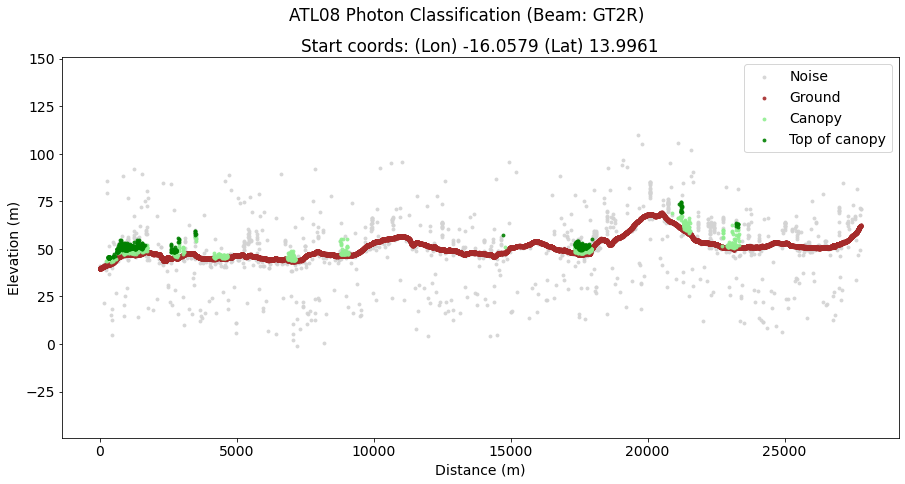

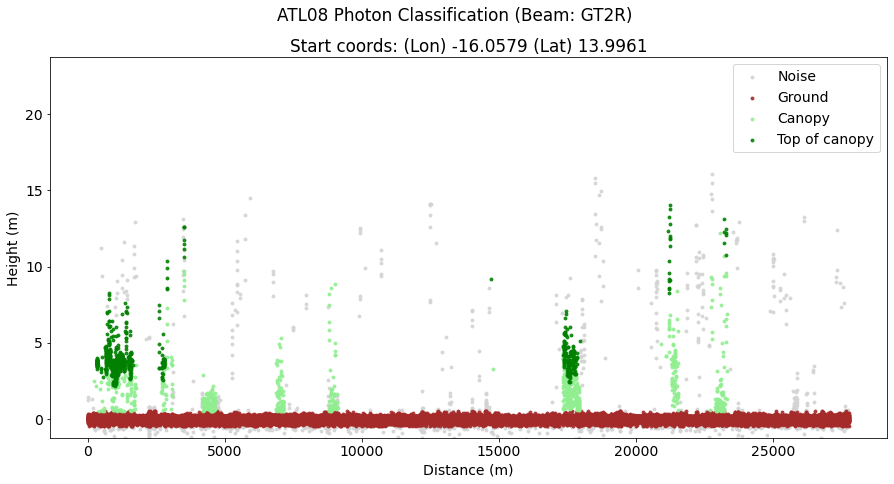

In [48]:
start_photon_num, transect_length_num_photons = 1000, 50000 #2099600, 23226
phcl = update(start=start_photon_num, transect_length=transect_length_num_photons, DO_HEIGHT=False)[0]
phcl = update(start=start_photon_num, transect_length=transect_length_num_photons, DO_HEIGHT=True)[0]

## Generate an interactive ATL03 transect plot showing classified photons

In [24]:
nrecords = x.shape[0]
ipywidgets.interact(update, start=ipywidgets.IntSlider(min=int(1e3), max=int(5e6), 
                                                       step=int(1e2), value=start_photon_num, 
                                                       continuous_update=False))

interactive(children=(IntSlider(value=1000, continuous_update=False, description='start', max=5000000, min=100…

<function __main__.update(start=0, transect_length=50000, DO_HEIGHT=True)>

## Build an ATL03 geodataframe

In [49]:
atl03_df = pd.DataFrame({'lon':longitude[valid], 'lat':latitude[valid], 'elev':elevation[valid], 'class':ph_class[valid], 'height':ph_height[valid]})
atl03_gdf_all = GeoDataFrame(atl03_df, geometry=gpd.points_from_xy(atl03_df.lon, atl03_df.lat), crs='epsg:4326')
atl03_gdf_all.head()

,lon,lat,elev,class,height,geometry
0,-16.057511,13.999996,37.540031,1,-0.004696,POINT (-16.05751 14.00000)
1,-16.057512,13.999990,37.533382,1,-0.011120,POINT (-16.05751 13.99999)
2,-16.057512,13.999990,37.604565,1,0.060326,POINT (-16.05751 13.99999)
3,-16.057511,13.999990,37.317646,1,-0.226303,POINT (-16.05751 13.99999)
4,-16.057512,13.999983,37.317753,1,-0.225864,POINT (-16.05751 13.99998)


In [50]:
# Just some basic checks
print(len(atl03_gdf_all))
print(len(longitude))
print(len(valid))
print(len(x))
print(len(atl03_gdf_all[atl03_gdf_all['class'] > 0]))
print(len(atl03_gdf_all[atl03_gdf_all['class'] == 1]))

2045900
2045900
2045900
2045900
1808514
1604049


## Find an ATL03 subset to map 
mapping all ATL03 photon is a bad idea

this is needed - it attaches a 'class_name' field that the map will need

In [61]:
# Subset the transect to a certain section
atl03_gdf_transect = subset_atl03(atl03_gdf_all, start=start_photon_num, transect_length=transect_length_num_photons)

if False:
    # Remove the Noise photons
    atl03_gdf_transect = atl03_gdf_transect[atl03_gdf_transect['class'] > 0]
    print(atl03_gdf_transect.shape)

if atl03_gdf_transect.shape[0] == 0:
    print('Find another transect - this has 0 photons')

/gpfsm/ccds01/home/appmgr/app/jupyterhub/ilab/kernel/lib/python3.7/site-packages/geopandas/geodataframe.py:1351: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


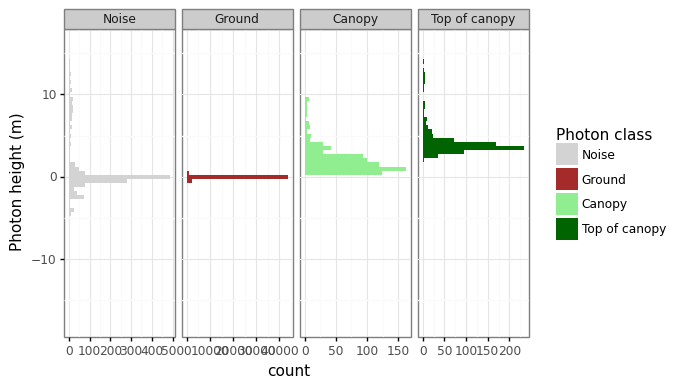

<ggplot: (2933535945505)>

In [80]:
plotnine.options.figure_size = (6, 4)
#atl03_gdf_all['class'] = atl03_gdf_all['class'].apply(str)
#atl03_gdf_transect['class_str'] = atl03_gdf_transect['class'].apply(str)
class_name_list = ['Noise','Ground','Canopy','Top of canopy']
class_color_list = ['lightgrey','brown','lightgreen','darkgreen']
(
      ggplot(atl03_gdf_transect, aes('height', fill='class_name'))
        + labs(x = 'Photon height (m)')
        + scale_fill_manual(values = class_color_list, name='Photon class')
        + geom_histogram(binwidth=0.5)
        + facet_wrap(' ~ class_name', ncol=4, scales = 'free_x')
    + coord_cartesian(ylim = (-5,15))
    + coord_flip()
    + theme_bw() 
)

### Subset, remove Noise, Clip to bounds and save to a csv of classified ATL03

In [98]:
atl03_gdf_sub = subset_atl03(atl03_gdf_all, start=start_photon_num, transect_length=atl03_gdf_all.shape[0])
atl03_gdf_sub = atl03_gdf_sub[~atl03_gdf_sub['class_name'].isin(['Noise'])].cx[minlon:maxlon, minlat:maxlat]
OUTDIR = f'/explore/nobackup/people/pmontesa/userfs02/projects/misc/icesat2_atl03_atl08_photons/{site}'
!mkdir -p $OUTDIR
out_fn = os.path.join(OUTDIR, f'{site}_classified_photons_' + os.path.splitext(g)[0].replace('ATL08','ATL03') + '.gpkg')
atl03_gdf_sub[['lat','lon','elev','class','height','geometry']].to_file(out_fn, driver='GPKG')

/gpfsm/ccds01/home/appmgr/app/jupyterhub/ilab/kernel/lib/python3.7/site-packages/geopandas/geodataframe.py:1351: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


## Generate an interactive map of ATL03 photons with ATL08 obs
- CAREFUL - these arent quality filtered using ATL08 yet
- they ARE clipped to the lat bounds of the ATL08 subset

In [97]:
atl03_gdf_sub.shape

(3185966, 8)

### Map ATL03 photon classes

In [257]:
%%time
import importlib
importlib.reload(maplib)
from folium import plugins

if False:
    m_atl03 = maplib.MAP_ATL03_FOLIUM(atl03_gdf_transect[atl03_gdf_transect['class'] > 0].sample(frac=1), zoom_start=12)
else:
    m_atl03 = maplib.ADD_ATL03_OBS_TO_MAP(atl03_gdf_transect[atl03_gdf_transect['class'] > 0].sample(frac=1), maplib.MAP_FOLIUM(lat_start =numpy.mean(atl03_gdf_transect.lat), lon_start = numpy.mean(atl03_gdf_transect.lon) ) )

#plugins.MousePosition().add_to(m_atl03)
m_atl03

CPU times: user 837 ms, sys: 122 ms, total: 959 ms
Wall time: 981 ms


### Map only Top-of-canopy

In [258]:
maplib.ADD_OBS_TO_MAP(atl03_gdf_transect[atl03_gdf_transect['class'] == 2].sample(frac=1), 'height', 
                      maplib.MAP_FOLIUM(zoom_start = 12, lat_start =numpy.mean(atl03_gdf_transect.lat), lon_start = numpy.mean(atl03_gdf_transect.lon) ),
                      RADIUS=5.5, MAP_TITLE='Vegetation height from  ATL03 Top of Canopy', VMAX = 12)

Mapping 2253 observations of height


## Generate an interactive map of ATL03 photons with ATL08 obs

In [ ]:
if False:
    atl08_gdf_sub = atl08_gdf[ (atl08_gdf.lat <= atl03_gdf.lat.max() ) & (atl08_gdf.lat >= atl03_gdf.lat.min() ) ]
    maplib.ADD_ATL08_OBS_TO_MAP(atl08_gdf_sub, MAP_COL='h_can', DO_NIGHT=False, NIGHT_FLAG_NAME='night_flg', foliumMap=m_atl03)
    #maplib.ADD_ATL03_OBS_TO_MAP(atl03_gdf[atl03_gdf['class']> 1], m_atl08)

### Summary:

1. Opened corresponding ATL08 and ATL03
2. Identified the attributes of interest for ATL08
3. Built an ATL08 df with those attributes
4. Subset by filtering with some of those attributes
5. Extracted the ATL03 x,y,z photon coordinates and classification (using ATL08)
6. Converted WGS84 coordinates to the EPSG 2.0 map grid
7. Generated a static & dynamic transect plot with a starting photon number and a photon transect length
8. Built an ATL03 geodataframe with x,y,z, and photon classification
9. Subset the ATL03 gdf using starting photon number and photon transect length, and removed noise photons
10. Generated an interactive map of the ground, canopy, and canopy top photons

TODO: Filter the ATL03_gdf using the filtered ATL08_gdf (only return the photons for the 'quality filtered' ATL08

### Reformulating notebook workflow from above into functions below

In [ ]:
import h5py
import os

import sys
sys.path.append('/home/pmontesa/code/gedipy')
from gedipy import h5io
sys.path.append('/home/pmontesa/code/icesat2_boreal/lib')
import FilterUtils
sys.path.append('/home/pmontesa/code/icesat2')
import extract_filter_atl08_v005

import numpy
import pyproj
import pandas as pd
import geopandas as gpd
from geopandas import GeoDataFrame

def get_powerbeams_atl03(atl03_fid):
        
    # SELECT POWER BEAMS
    # Which beams are power/weak depends on the orientation of the satellite
    atlas_orientation = atl03_fid.get_atlas_orientation()
    if atlas_orientation == 'backward':
        power_beams = [beam for beam in atl03_fid.beams if beam.endswith('l')]
    elif atlas_orientation == 'forward':
        power_beams = [beam for beam in atl03_fid.beams if beam.endswith('r')]
    else:
        print('ATLAS orientation in transition, do not use')

    return power_beams

def project_valid_4326(longitude, latitude, out_epsg = 'epsg:6933'):
    
    inproj = pyproj.Proj(init='epsg:4326')
    outproj = pyproj.Proj(init=out_epsg)
    valid = ~numpy.isnan(longitude)
    valid &= ~numpy.isnan(latitude)
    
    x,y = pyproj.transform(inproj, outproj, longitude[valid], latitude[valid])
    
    return x,y

def write_atl03_gpkg(atl03_gdf_all, granule_name: str, start_photon_num: int, num_photons_transect: int, sitename: str, 
                bbox: list,
                OUTDIR = '/explore/nobackup/people/pmontesa/userfs02/projects/misc/icesat2_atl03_atl08_photons'):
    
    minlon, maxlon, minlat, maxlat = bbox
    
    atl03_gdf_sub = subset_atl03(atl03_gdf_all, start=start_photon_num, transect_length=num_photons_transect)
    atl03_gdf_sub = atl03_gdf_sub[~atl03_gdf_sub['class_name'].isin(['Noise'])].cx[minlon:maxlon, minlat:maxlat]
    OUTDIR = f'{OUTDIR}/{sitename}'
    #!mkdir -p $OUTDIR
    out_fn = os.path.join(OUTDIR, f'{sitename}_classified_photons_' + os.path.splitext(granule_name)[0].replace('ATL08','ATL03') + '.gpkg')
    atl03_gdf_sub[['lat','lon','elev','class','height_m','geometry']].to_file(out_fn, driver='GPKG')

    return atl03_gdf_sub

def get_atl03_photon_gdf(atl03_fid, atl08_fid, power_beams: list, min_lat, max_lat):
    
    # Get photon xyz location from ATL03
    longitude, latitude, elevation  = [numpy.concatenate([atl03_fid.get_coordinates(beam, ht=True)[i] for beam in power_beams]) for i in range(0,3)]
    
    # Get photon class and height value from ATL08
    ph_class = numpy.concatenate([atl03_fid.get_photon_labels(beam, atl08_fid) for beam in power_beams], axis=None)
    ph_height = numpy.concatenate([atl03_fid.get_photon_height(beam, atl08_fid) for beam in power_beams], axis=None)

    # Filter by latitude
    longitude, latitude, elevation, ph_class, ph_height = [v[(latitude < maxlat) & (latitude > minlat)] for v in [longitude, latitude, elevation, ph_class, ph_height]]
    
    # Find valid ATL03 photons using lat,lon
    valid = ~numpy.isnan(longitude)
    valid &= ~numpy.isnan(latitude)

    # Convert ATL03 to a geodataframe
    atl03_df = pd.DataFrame({'lon':longitude[valid], 'lat':latitude[valid], 'elev':elevation[valid], 'class':ph_class[valid], 'height':ph_height[valid]})
    atl03_gdf_all = GeoDataFrame(atl03_df, geometry=gpd.points_from_xy(atl03_df.lon, atl03_df.lat), crs='epsg:4326')
    atl03_df = None
    
    return atl03_gdf_all

def extract_atl08_gedipy(atl08_fid, power_beams: list):
    
    '''Extract ATL08 obs using the GEDIPY lib'''
    
    # Make these the same as what you get from extract_filter_atl08
    dataset_list_for_export = ['land_segments/latitude','land_segments/longitude',
                           'land_segments/solar_elevation',
                           'land_segments/msw_flag','land_segments/segment_snowcover','land_segments/segment_watermask','land_segments/night_flag','land_segments/segment_landcover',
                          'land_segments/canopy/h_canopy','land_segments/canopy/n_toc_photons','land_segments/canopy/n_ca_photons']

    dataset_terrain_list_for_export = ['land_segments/terrain/h_te_best_fit','land_segments/terrain/h_te_interp','land_segments/terrain/h_te_max','land_segments/terrain/h_te_mean','land_segments/terrain/h_te_median',
'land_segments/terrain/h_te_min','land_segments/terrain/h_te_mode','land_segments/terrain/h_te_rh25','land_segments/terrain/h_te_skew','land_segments/terrain/h_te_std','land_segments/terrain/h_te_uncertainty', 'land_segments/terrain/terrain_slope']

    atl08_df = pd.concat([ atl08_fid.export_shots(beam, subset=False, dataset_list=dataset_list_for_export + dataset_terrain_list_for_export) for beam in power_beams]) 

    atl08_df.rename(columns={'longitude': 'lon', 'latitude': 'lat', 'night_flag':'night_flg', 'h_canopy':'h_can'}, inplace=True)
    #atl08_gdf = GeoDataFrame(atl08_df, geometry=gpd.points_from_xy(atl08_df.lon, atl08_df.lat), crs='epsg:4326')
    atl08_df = atl08_df[
                                        (atl08_gdf.msw_flag == 0) & 
                                        (atl08_gdf.n_ca_photons > 0) &
                                        (atl08_gdf.h_can < 100) &
                                        (atl08_gdf.segment_snowcover == 1) &
                                        (atl08_gdf.segment_watermask == 0)
                                    ]
    return atl08_df

def extract_atl03(atl08_granule_name, ATLAS_version, DIR_ATLAS = '/css/icesat-2/ATLAS', minmonth = 6, maxmonth = 9):
    
    # ACCESS ATL08 and ATL03 file pairs
    #
    # Get filename portions of the granule name 
    g1, g2, g3, g4, g5 = atl08_granule_name.split('_')
    atl03_filename = f'{DIR_ATLAS}/ATL03.{ATLAS_version:003}/{g2[0:4]}.{g2[4:6]}.{g2[6:8]}/ATL03_{g2}_{g3}_{ATLAS_version:003}_01.h5'
    atl08_filename = f'{DIR_ATLAS}/ATL08.{ATLAS_version:003}/{g2[0:4]}.{g2[4:6]}.{g2[6:8]}/ATL08_{g2}_{g3}_{ATLAS_version:003}_01.h5'
    
    # Get ATL03 filename from ATL08 filename
    atl08_file = h5py.File(atl08_filename, 'r')
    
    # Get beamlist from ATL08
    beamlist = [group for i, group in enumerate(list(atl08_file)) if 'gt' in group]
    print(f'Ground tracks are: {beamlist}')

    atl03_file = h5py.File(atl03_filename, 'r')
    
    # OPEN the files
    # Open the ATL03 file
    atl03_fid = h5io.ATL03H5File(atl03_filename)
    atl03_fid.open_h5()

    # Open the ATL08 file
    atl08_fid = h5io.ATL08H5File(atl08_filename)
    atl08_fid.open_h5()
    
    # Get the power beams
    power_beams = get_powerbeams_atl03(atl03_fid)
    
    # Select the RGT center power beam for this example
    beam = next(power_beam for power_beam in power_beams if 'gt2' in power_beam)

    # Is it night or day?
    night_flag = atl08_fid.get_dataset(beam, 'land_segments/night_flag')
    print('{:.2f}% of the land segments are night time'.format(sum(night_flag)/night_flag.size))
    
    # Get an ATL08 gdf
    '''
    # Ideally, we want just the ATL03 photons for the ATL08 that we have filtered
    # Run icesat2 ATL08 extraction
    # TODO how to do this using our existing code?
    # 
    # This is a custom quality filter with misc thresholds applied to specified columns! NOTE: sol_el threshold not included, so USING DAYTIME DATA HERE
    # This LC h_can thresh list is same as boreal.
    atl08_df = extract_filter_atl08_v005.main( 
                            --i {atl08_filename}
                            --list_lc_h_can_thresh 0 60 60 60 60 60 60 50 50 50 50 50 50 15 10 10 5 5 5 0 0 0 0
                            --minlon -69 --maxlon -68 --minlat 44 --maxlat 46 --minmonth 6 --maxmonth 9 
                            --dict_misc_thresh {"h_can_unc": 5, "seg_cover": 32767, "sig_topo": 2.5, "h_dif_ref": 25} 
                            --do_20m
                            --output_dataframe
                            )                            
    '''
    atl08_df = extract_atl08_gedipy(atl08_fid, power_beams)
    atl08_df = FilterUtils.prep_filter_atl08_qual(atl08_df)
    print('Quality filtering with aggressive land-cover based (v3) filters updated in Jan/Feb 2022 ...')
    atl08_pdf_filt = FilterUtils.filter_atl08_qual_v3(atl08_df, SUBSET_COLS=False, DO_PREP=False,
                                                   #subset_cols_list = atl08_cols_list + ['seg_cover'], #, 'granule_name'
                                                   filt_cols=['h_can','h_dif_ref','m','msw_flg','beam_type','seg_snow','sig_topo'], 
                                                   list_lc_h_can_thresh=[0, 60, 60, 60, 60, 60, 60, 50, 50, 50, 50, 50, 50, 15, 10, 10, 5, 5, 5, 0, 0, 0, 0],
                                                   thresh_h_can=100, thresh_h_dif=25, thresh_sig_topo=2.5, month_min=minmonth, month_max=maxmonth)
    
    # Convert ATL08 to a geodataframe
    atl08_gdf = GeoDataFrame(atl08_df, geometry=gpd.points_from_xy(atl08_df.lon, atl08_df.lat), crs='epsg:4326')
    atl08_df = None
    
    return gdf